<a href="https://colab.research.google.com/github/fasyuzz/fasyuzz/blob/main/U2101063_W2_Image_Processing_in_Python.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Introduction to Image Processing in Python**

>This tutorial provides an introduction to basic image processing techniques using the OpenCV computer vision library and some standard data analysis libraries in Python.

*Useful intro about [Colab](https://colab.research.google.com/notebooks/welcome.ipynb)*

*Useful intro about [OpenCV](https://docs.opencv.org/4.x/index.html)*








##Load the Dependencies

> This section loads some required libraries used in this notebook: **numpy**, **pandas**, **cv2**, **skimage**, **matplotlib**

*   [Numpy](https://www.numpy.org/) is an array manipulation library, used for linear algebra, Fourier transform, and random number capabilities.
*   [Pandas](https://pandas.pydata.org/) is a library for data manipulation and data analysis.
*   [CV2](https://docs.opencv.org/4.x/index.html) is a library for computer vision tasks.
*   [Skimage](https://scikit-image.org/) is a library which supports image processing applications on python.
*   [Matplotlib](https://matplotlib.org/) is a library which generates figures and provides graphical user interface toolkit.









In [ ]:
import numpy as np
import pandas as pd
import cv2 as cv
from google.colab.patches import cv2_imshow # for image display
from skimage import io
from PIL import Image
import matplotlib.pylab as plt

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


##Read Image from urls

> In this step we will read images from urls, and display them using openCV, please note the difference when reading image in RGB and BGR format. The default input color channels are in BGR format for openCV. But what happens when you do not specify?

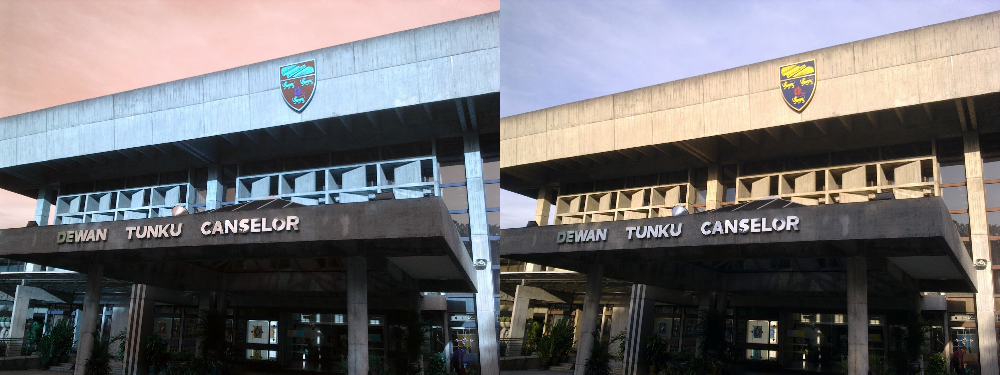

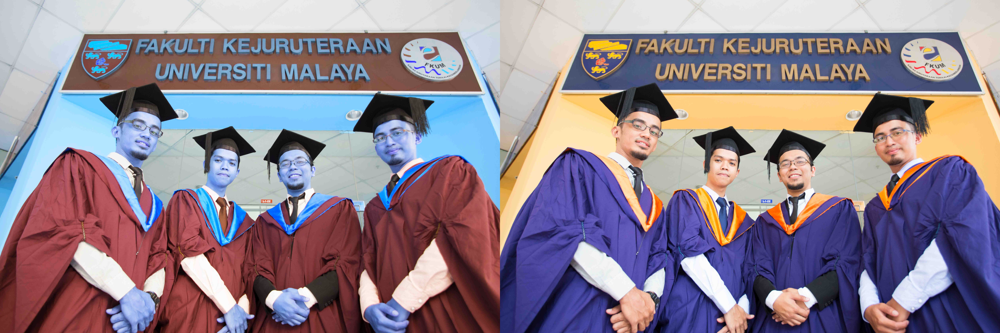

In [ ]:
# Create a list to store the urls of the images
urls = ["https://upload.wikimedia.org/wikipedia/commons/1/14/Gambar_Dewan_Tunku_Canselor%2C_Universiti_Malaya.jpg",
       "https://harissalehanportraiture.wordpress.com/wp-content/uploads/2014/11/img_1123.jpg"]
# Read and display the image
# loop over the image URLs, you could store several image urls in the list

for url in urls:
  image = io.imread(url)
  image_2 = cv.cvtColor(image, cv.COLOR_BGR2RGB)
  final_frame = cv.hconcat((image, image_2))
  cv2_imshow(final_frame)
  print('\n')

#### TODO: Read an image from a URL and display it

Image source examples:

[Google Image search](https://www.google.com/imghp?hl=en) - search for an image. Left-click one of the returned images, then right-click on the full image, and then select "Copy Image Address".

In [ ]:
## TODO: LOAD IMAGE
## url =
## myImg = io.imread(url)
## cv2_imshow(cv.cvtColor(myImg, cv.COLOR_BGR2RGB))


## Arithmetic Operations

> Arithmetic operations are the foundational mathematical manipulations applied to pixel values in images. These include basic operations such as addition, subtraction, multiplication, and division. They are used for tasks like brightness adjustment, contrast enhancement, and combining multiple images. For instance, adding a constant value to all pixels can brighten an image, while subtracting can be used for contrast adjustments.

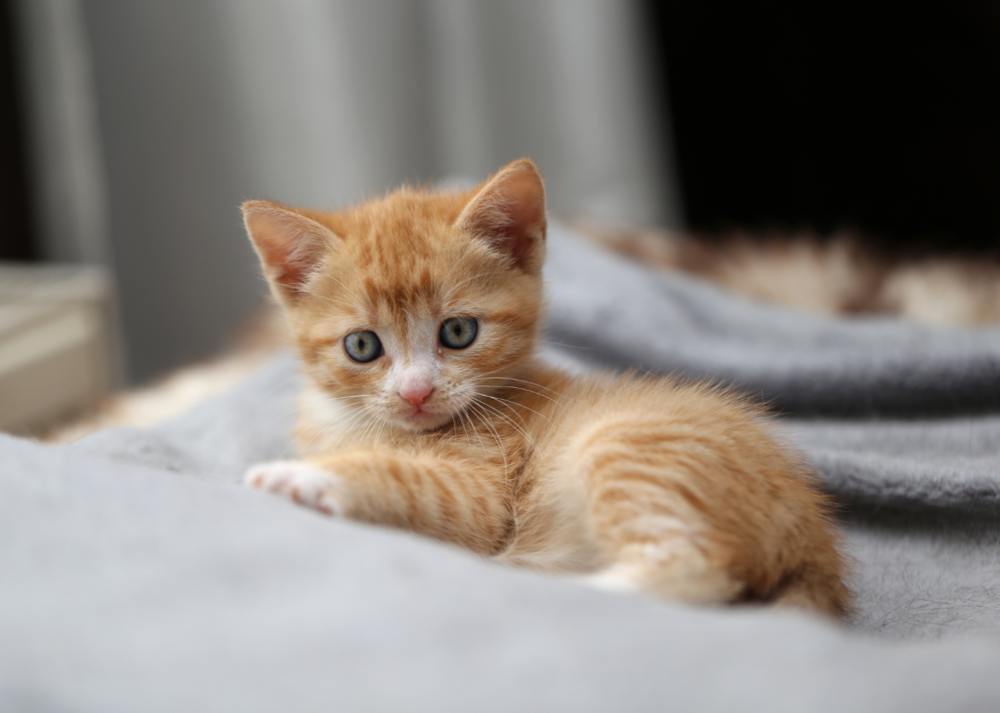

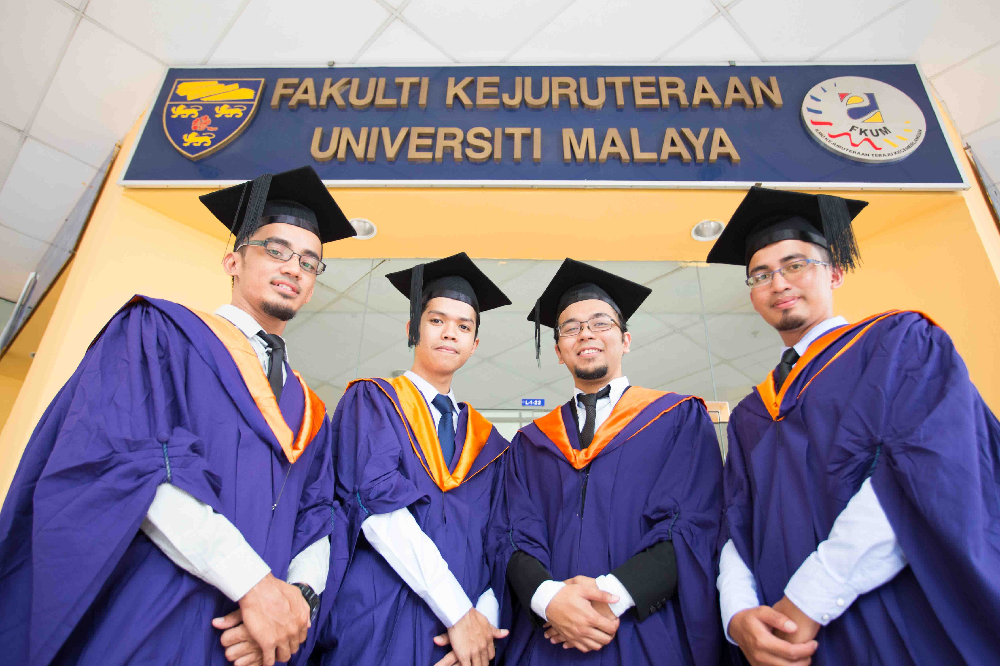

In [ ]:
#read image
img1 = io.imread("https://www.catschool.co/wp-content/uploads/2023/06/orange-tabby-kitten-1024x731.png")
img2 = io.imread("https://harissalehanportraiture.wordpress.com/wp-content/uploads/2014/11/img_1123.jpg")

#display
cv2_imshow(cv.cvtColor(img1, cv.COLOR_BGR2RGB))
cv2_imshow(cv.cvtColor(img2, cv.COLOR_BGR2RGB))

In [ ]:
# Resize images if they are not the same size
if img1.shape != img2.shape:
    img2 = cv.resize(img2, (img1.shape[1], img1.shape[0]))

In [ ]:
# Check the image matrix data type (could know the bit depth of the image)
print(img1.dtype)
# Check the height of image
print(img1.shape[0])
# Check the width of image
print(img1.shape[1])
# Check the number of channels of the image
print(img1.shape[2])

uint8
731
1024
4


In [ ]:
# Check the image matrix data type (could know the bit depth of the image)
print(img2.dtype)
# Check the height of image
print(img2.shape[0])
# Check the width of image
print(img2.shape[1])
# Check the number of channels of the image
print(img2.shape[2])

uint8
731
1024
3


In [ ]:
# Convert to Grayscale
img1_g = cv.cvtColor(img1, cv.COLOR_BGR2GRAY)
img2_g = cv.cvtColor(img2, cv.COLOR_BGR2GRAY)

### Addition

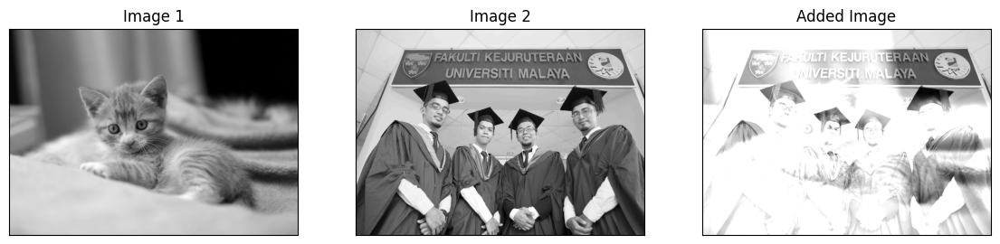

In [ ]:
# Perform addition
added_image = cv.add(img1_g, img2_g)

plt.figure(figsize=(14, 8))
plt.subplot(131), plt.imshow(img1_g, cmap = 'gray')
plt.title('Image 1'), plt.xticks([]), plt.yticks([])
plt.subplot(132), plt.imshow(img2_g, cmap = 'gray')
plt.title('Image 2'), plt.xticks([]), plt.yticks([])
plt.subplot(133), plt.imshow(added_image, cmap = 'gray')
plt.title('Added Image'), plt.xticks([]), plt.yticks([])
plt.show()

### Subtraction

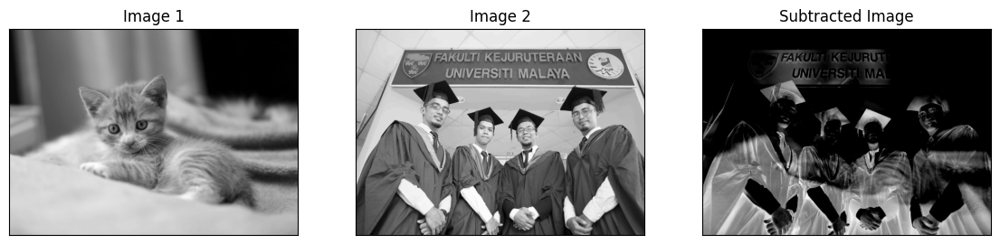

In [ ]:
# Perform subtraction
sub_image = cv.subtract(img1_g, img2_g)

plt.figure(figsize=(14, 8))
plt.subplot(131), plt.imshow(img1_g, cmap = 'gray')
plt.title('Image 1'), plt.xticks([]), plt.yticks([])
plt.subplot(132), plt.imshow(img2_g, cmap = 'gray')
plt.title('Image 2'), plt.xticks([]), plt.yticks([])
plt.subplot(133), plt.imshow(sub_image, cmap = 'gray')
plt.title('Subtracted Image'), plt.xticks([]), plt.yticks([])
plt.show()

#### TODO : Perform multiplication

In [ ]:
##TODO : Perform mulitplication
## Observe the output and explain.



## Set and Logical Operations

> Set and logical operations focus on manipulating sets of pixel values based on logical conditions. Common operations include AND, OR, and NOT, which help in binary image processing, masking, and image segmentation. These operations allow for the selective modification of pixel values based on specific criteria, making them essential for tasks like object detection and feature extraction.


##### Set Operations

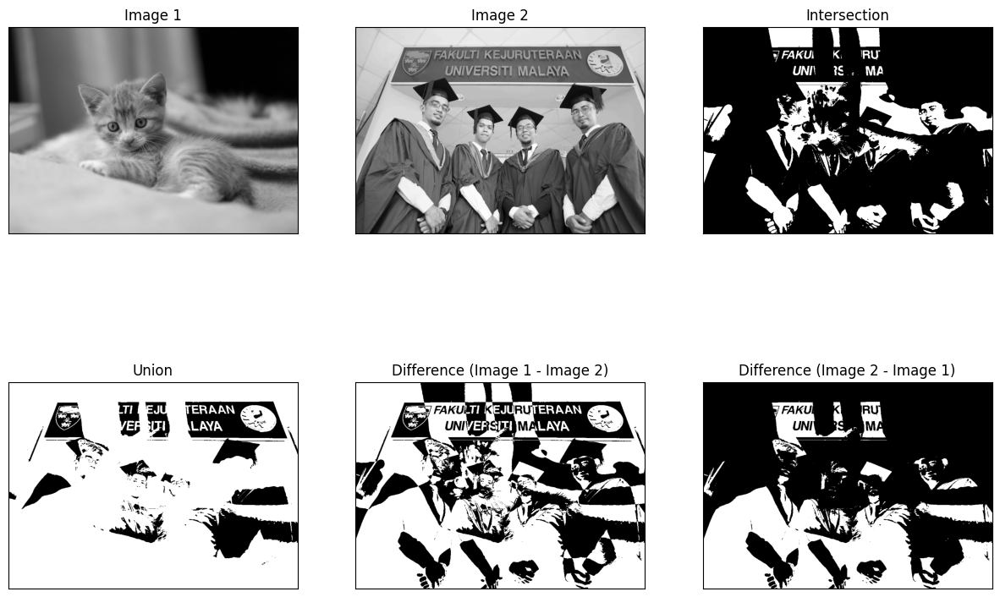

In [ ]:
# Apply thresholding to create binary masks
_, mask1 = cv.threshold(img1_g, 128, 255, cv.THRESH_BINARY)
_, mask2 = cv.threshold(img2_g, 128, 255, cv.THRESH_BINARY)

# Set Operations
# Intersection
intersection = cv.bitwise_and(mask1, mask2)

# Union
union = cv.bitwise_or(mask1, mask2)

# Difference
difference1 = cv.bitwise_xor(mask1, mask2)  # mask1 - mask2
difference2 = cv.subtract(mask1, mask2)    # mask2 - mask1

# Display the images
plt.figure(figsize=(15, 10))

plt.subplot(231), plt.imshow(cv.cvtColor(img1_g, cv.COLOR_BGR2RGB))
plt.title('Image 1'), plt.xticks([]), plt.yticks([])
plt.subplot(232), plt.imshow(cv.cvtColor(img2_g, cv.COLOR_BGR2RGB))
plt.title('Image 2'), plt.xticks([]), plt.yticks([])
plt.subplot(233), plt.imshow(intersection, cmap='gray')
plt.title('Intersection'), plt.xticks([]), plt.yticks([])
plt.subplot(234), plt.imshow(union, cmap='gray')
plt.title('Union'), plt.xticks([]), plt.yticks([])
plt.subplot(235), plt.imshow(difference1, cmap='gray')
plt.title('Difference (Image 1 - Image 2)'), plt.xticks([]), plt.yticks([])
plt.subplot(236), plt.imshow(difference2, cmap='gray')
plt.title('Difference (Image 2 - Image 1)'), plt.xticks([]), plt.yticks([])

plt.show()

#### Logical Operations

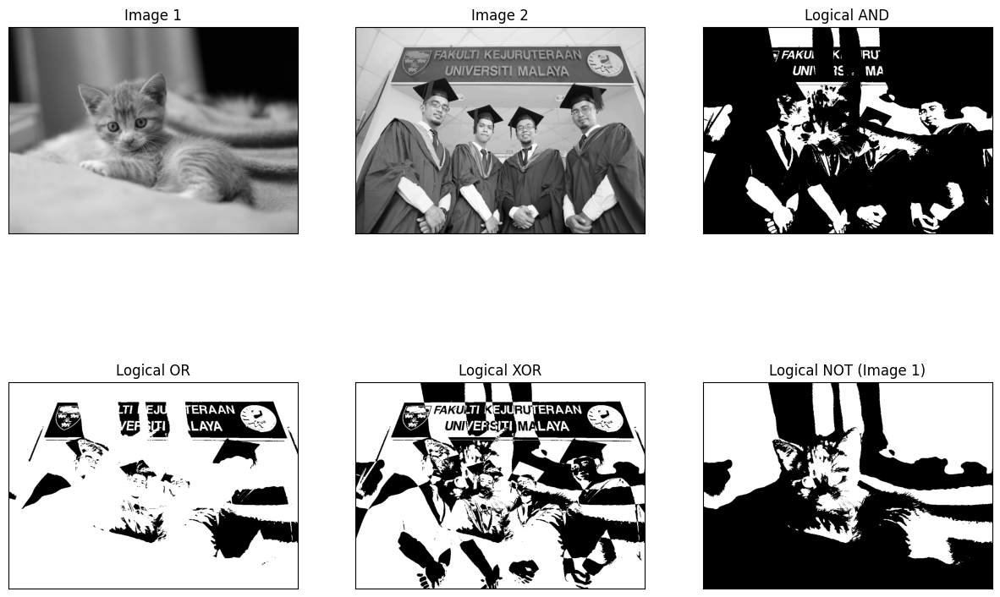

In [ ]:
# Logical Operations
logical_and = cv.bitwise_and(mask1, mask2)
logical_or = cv.bitwise_or(mask1, mask2)
logical_xor = cv.bitwise_xor(mask1, mask2)
logical_not1 = cv.bitwise_not(mask1)
logical_not2 = cv.bitwise_not(mask2)

# Display the images
plt.figure(figsize=(15, 10))

plt.subplot(231), plt.imshow(cv.cvtColor(img1_g, cv.COLOR_BGR2RGB))
plt.title('Image 1'), plt.xticks([]), plt.yticks([])
plt.subplot(232), plt.imshow(cv.cvtColor(img2_g, cv.COLOR_BGR2RGB))
plt.title('Image 2'), plt.xticks([]), plt.yticks([])
plt.subplot(233), plt.imshow(logical_and, cmap='gray')
plt.title('Logical AND'), plt.xticks([]), plt.yticks([])
plt.subplot(234), plt.imshow(logical_or, cmap='gray')
plt.title('Logical OR'), plt.xticks([]), plt.yticks([])
plt.subplot(235), plt.imshow(logical_xor, cmap='gray')
plt.title('Logical XOR'), plt.xticks([]), plt.yticks([])
plt.subplot(236), plt.imshow(logical_not1, cmap='gray')
plt.title('Logical NOT (Image 1)'), plt.xticks([]), plt.yticks([])

plt.show()

#### TODO : Perform other Set and Logical Operations

In [ ]:
##TODO

## Spatial Operations

> Spatial operations refer to techniques that manipulate images based on the spatial arrangement of pixels. This includes geometric transformations such as translation, rotation, and scaling, as well as spatial filtering techniques like convolution and blurring. Spatial operations are critical for correcting image distortions, enhancing features, and preparing images for further analysis.


##### Blurring and Sharpening

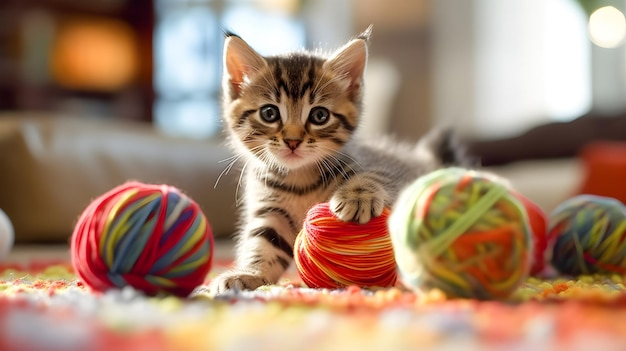

In [ ]:
# Load and display image
imgN = io.imread("https://img.freepik.com/premium-photo/cute-little-kitten-playing-with-colorful-wool-balls-concept-love-animals-pets-generative-ai_853928-216.jpg")
imgN_g = cv.cvtColor(imgN, cv.COLOR_BGR2GRAY)

cv2_imshow(cv.cvtColor(imgN, cv.COLOR_BGR2RGB))

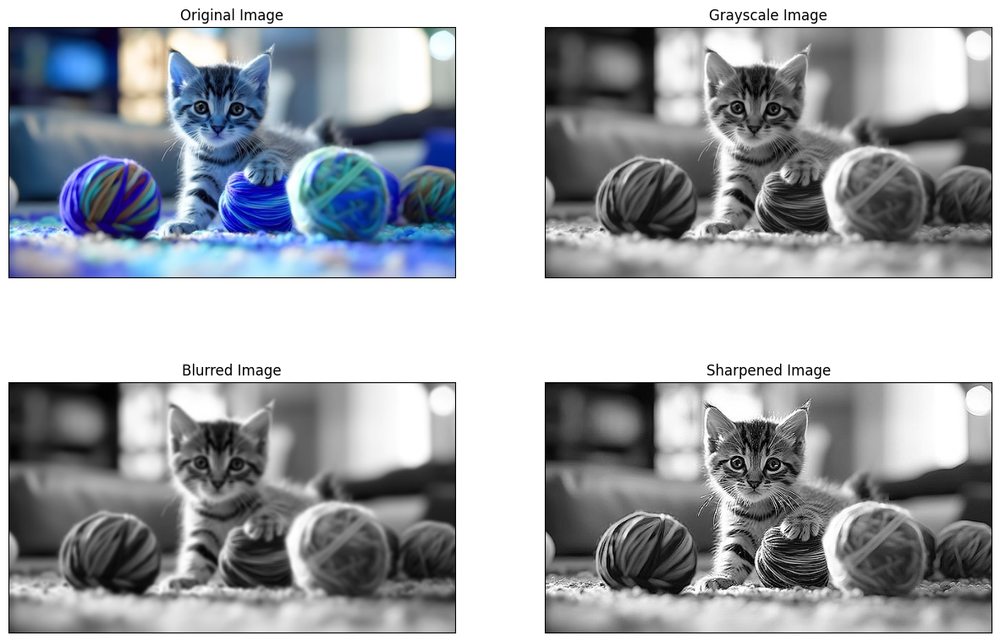

In [ ]:
# Define a kernel for spatial operations
# Example: 5x5 Gaussian kernel for blurring
kernel_blur = np.ones((5, 5), np.float32) / 25

# Example: 3x3 sharpening kernel
kernel_sharpen = np.array([[0, -1, 0],
                            [-1, 5, -1],
                            [0, -1, 0]])

# Perform blurring
blurred_image = cv.filter2D(imgN_g, -1, kernel_blur)

# Perform sharpening
sharpened_image = cv.filter2D(imgN_g, -1, kernel_sharpen)

# Display the images
plt.figure(figsize=(15, 10))

plt.subplot(221), plt.imshow(cv.cvtColor(imgN, cv.COLOR_BGR2RGB))
plt.title('Original Image'), plt.xticks([]), plt.yticks([])

plt.subplot(222), plt.imshow(imgN_g, cmap='gray')
plt.title('Grayscale Image'), plt.xticks([]), plt.yticks([])

plt.subplot(223), plt.imshow(blurred_image, cmap='gray')
plt.title('Blurred Image'), plt.xticks([]), plt.yticks([])

plt.subplot(224), plt.imshow(sharpened_image, cmap='gray')
plt.title('Sharpened Image'), plt.xticks([]), plt.yticks([])

plt.show()

#### TODO : Perform other Spatial Operations

In [ ]:
##TODO: Perform other Spatial Operations

## Vector Operations

> Vectors and matrices are fundamental structures in image processing, representing image data in mathematical form. Operations on vectors and matrices, such as addition, multiplication, and inversion, are essential for performing tasks like image transformations, filtering, and feature extraction. Understanding these operations enables efficient manipulation of multi-dimensional image data.


#### Image Inversion

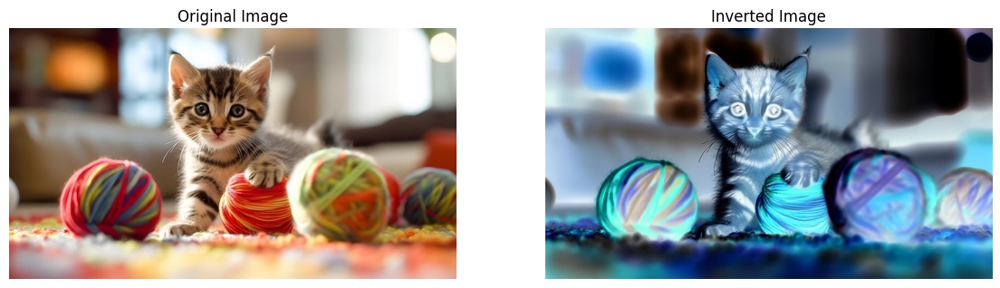

In [ ]:
# Invert the image
inverted_image = 255 - imgN

# Display the original and inverted images
plt.figure(figsize=(14, 8))

plt.subplot(1, 2, 1)
plt.imshow(imgN)
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(inverted_image)
plt.title('Inverted Image')
plt.axis('off')

plt.show()

#### TODO : Perform other Vector Operations

In [ ]:
##TODO: Perform other Vector Operations

## Probabilistic Method & Image Transform

> Image transforms are mathematical techniques used to convert images into different domains for analysis. Common transforms include the Fourier transform, which helps analyze frequency components, and the wavelet transform, used for multi-resolution analysis. Transforms facilitate tasks like image compression, noise reduction, and feature extraction by providing alternative representations of the image data.

### Image Contours and Histograms

In [ ]:
myImg = io.imread("https://img.freepik.com/premium-photo/cute-little-kitten-playing-with-colorful-wool-balls-concept-love-animals-pets-generative-ai_853928-216.jpg")

# Check the image matrix data type (could know the bit depth of the image)
print(myImg.dtype)
# Check the height of image
print(myImg.shape[0])
# Check the width of image
print(myImg.shape[1])
# Check the number of channels of the image
print(myImg.shape[2])

uint8
351
626
3


### Generate Histogram of color image and grayscale image
Sometimes you want to enhance the contrast in your image or expand the contrast in a particular region while sacrificing the detail in colors that don’t vary much, or don’t matter. A good tool to find interesting regions is the histogram. To create a histogram of our image data, we use the matplot.pylab `hist()` function.

More info: [Histogram](https://docs.opencv.org/4.x/d1/db7/tutorial_py_histogram_begins.html)

Display the histogram of all the pixels in the color image

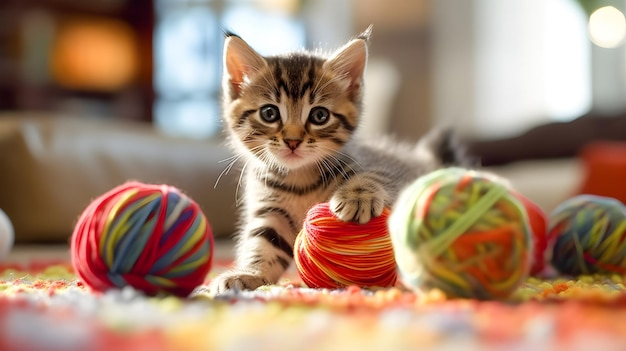

In [ ]:
image = myImg;
cv2_imshow(cv.cvtColor(image, cv.COLOR_BGR2RGB))

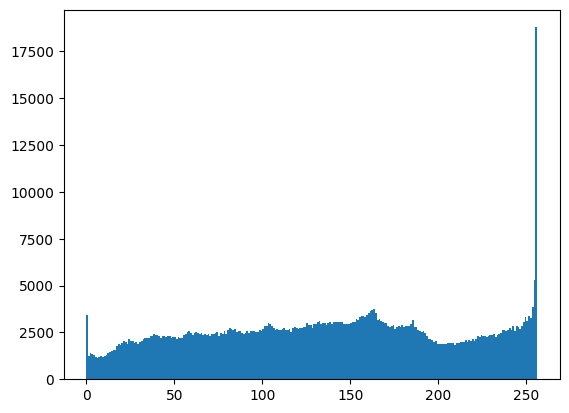

In [ ]:
# Plot Histogram

plt.hist(image.ravel(),bins = 256, range = [0,256])
plt.show()

Display the histogram of R, G, B channel.

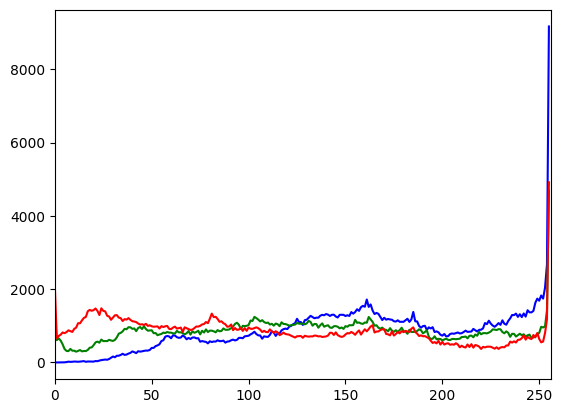

In [ ]:
color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv.calcHist([image],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
plt.show()

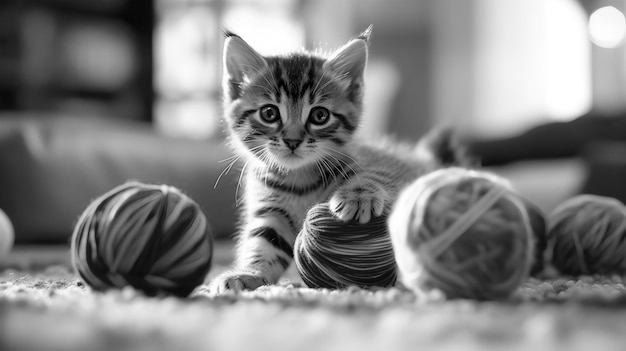

In [ ]:
gray_image = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
cv2_imshow(gray_image)

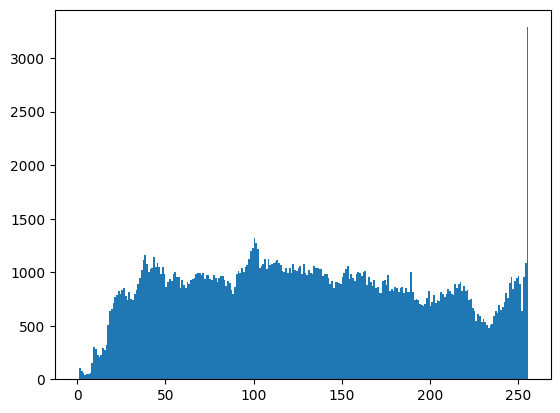

In [ ]:
# Plot the histogram of the gray image. We could observe that the frequency of
# the image histogram has decreased ~ 1/3 of the histogram of color image
plt.hist(gray_image.ravel(),bins = 256, range = [0, 256])
plt.show()

 #### TODO: Display the grayscale of your color image and generate histogram


In [ ]:
#myGrayImg = cv.cvtColor(myImg, cv.COLOR_BGR2GRAY)
#cv2_imshow()

### Find image contour of the grayscale image

Method 1: Use the matplotlib. contour

More Info: [matplotlib contour](https://matplotlib.org/api/_as_gen/matplotlib.pyplot.contour.html)

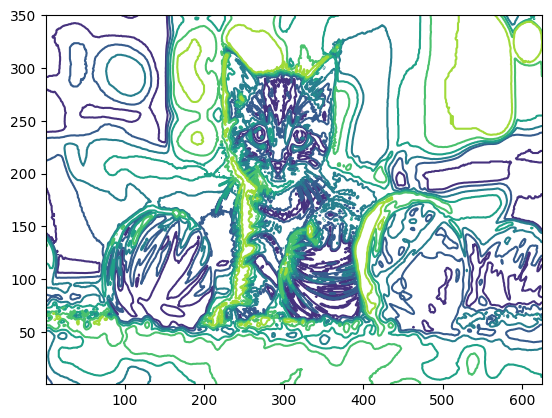

In [ ]:
plt.contour(gray_image, origin = "image")

Method 2: Use the openCV lib

More info: [Contour](https://docs.opencv.org/3.1.0/d4/d73/tutorial_py_contours_begin.html)

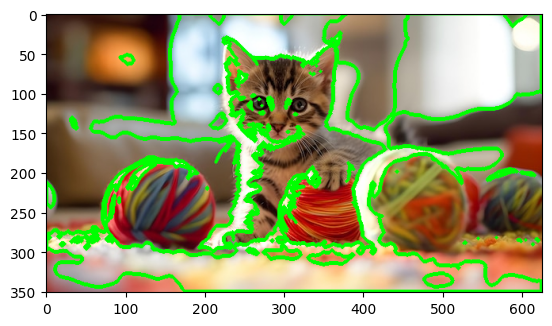

In [ ]:
# Set threshold for the countour detection
ret, thresh = cv.threshold(gray_image,150,255,0)
contours, hierarchy = cv.findContours(thresh, cv.RETR_TREE, cv.CHAIN_APPROX_SIMPLE)
cv.drawContours(image, contours, -1, (0, 255, 0), 3)
plt.imshow(image)

#### TODO: Find the contour of your own image

In [ ]:
# Your code
# plt.contour()

### Grayscale Transform and Histogram Equalization


### Grayscale Transformation
This section provides some examples of conducting mathematical transformations of the grayscale image

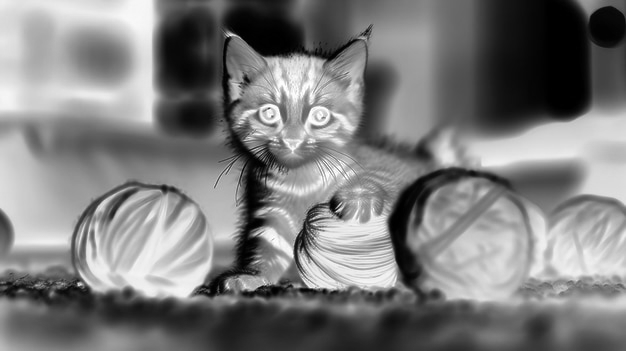

In [ ]:
# This is an inverse operation of the grayscale image, you could see that the
# bright pixels become dark, and the dark pixels become bright
im2 = 255 - gray_image
cv2_imshow(im2)

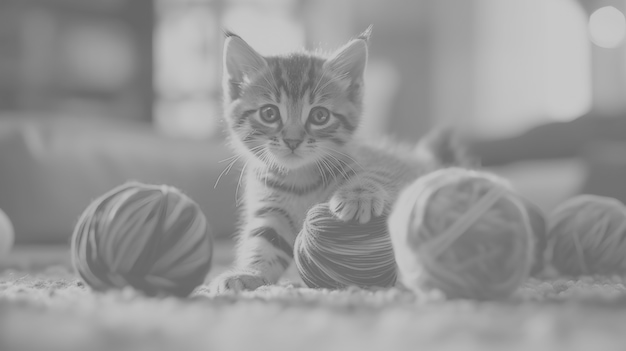

In [ ]:
# Another transform of the image, after adding a constant,
# all the pixels become brighter and a hazing-like effect of the image is generated
im3 = (100.0/255)*gray_image + 100
cv2_imshow(im3)

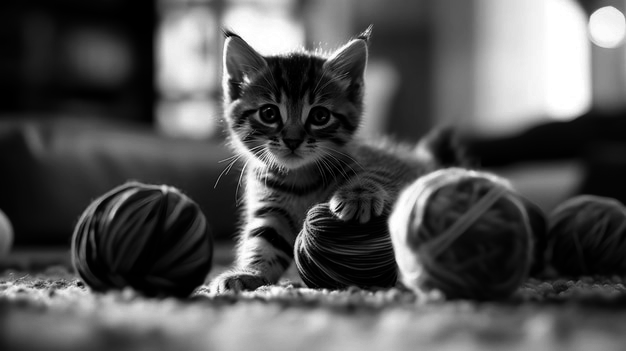

In [ ]:
# The lightness level of the gray_image decreases after this step
im4 = 255.0*(gray_image/255.0)**2
cv2_imshow(im4)

#### TODO: Try some mathematical operations on your image


In [ ]:
## Implement your code here
## myGrayImgTrans = myGrayImg...
## cv2_imshow(myGrayImgTrans)

### Histogram Equalization
This section demonstrates histogram equalization on a dark image. This transform flattens the gray-level histogram so that all intensities are as equally common as possible. The transform function is a cumulative distribution function (cdf) of the pixel values in the image (normalized to map the range of pixel values to the desired range). This example uses image 4 (im4).

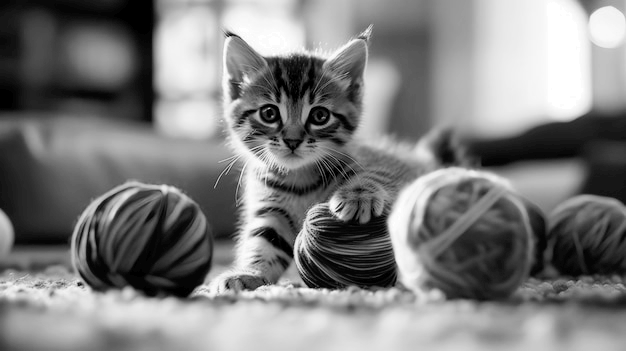

In [ ]:
# function of histogram equalization
def histeq(im, nbr_bins = 256):
  """ Histogram equalization of a grayscale image.  """
  # get the image histogram
  imhist, bins = np.histogram(im.flatten(), nbr_bins, [0, 256])
  cdf = imhist.cumsum() # cumulative distribution function
  cdf = imhist.max()*cdf/cdf.max()  #normalize
  cdf_mask = np.ma.masked_equal(cdf, 0)
  cdf_mask = (cdf_mask - cdf_mask.min())*255/(cdf_mask.max()-cdf_mask.min())
  cdf = np.ma.filled(cdf_mask,0).astype('uint8')
  return cdf[im.astype('uint8')]

# apply the function on your dark image to increase the contrast
# we could observe that the contrast of the black background has increased
im5 = histeq(im4)
cv2_imshow(im5)

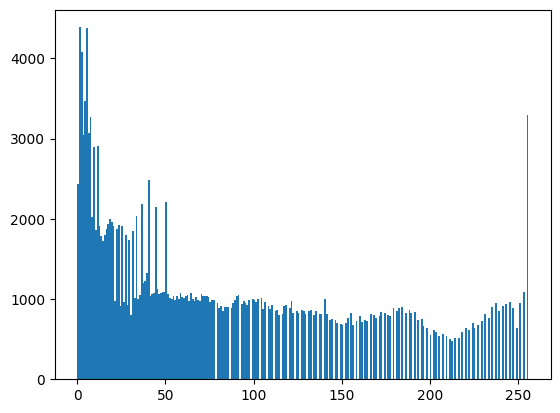

In [ ]:
# Extra: try to visualize the histogram of the image after histogram equalization
# Before histogram equalization
plt.hist(im4.ravel(),bins = 256, range = [0, 256])
plt.show()

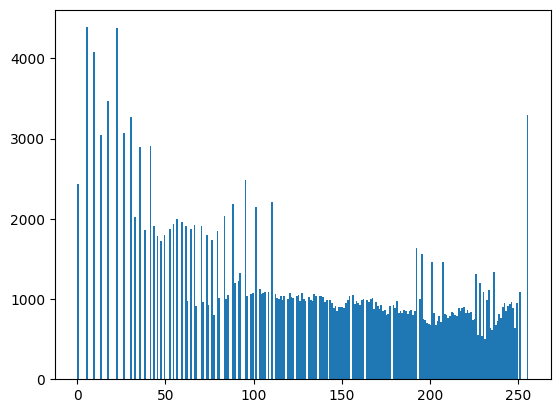

In [ ]:
# After histogram equalization
plt.hist(im5.ravel(),bins = 256, range = [0, 256])
plt.show()

#### TODO: Do a histogram equalization on your grayscale image



In [ ]:
## TODO: IMPLEMENT YOUR CODE HERE
## CODE INSTRUCTION
##plt.imshow()

### Fourier Transform of Gray Images
[FFT](https://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_imgproc/py_transforms/py_fourier_transform/py_fourier_transform.html)
> A fourier transform is used to find the frequency domian of an image. You can consider an image as a signal which is sampled in two directions. So taking a fourier transform in both X and Y directions gives you the frequency representation of image. For the sinusoidal signal, if the amplitude varies so fast in short time, you can say it is a high frequency signal. If it varies slowly, it is a low frequency signal. Edges and noises are high frequency contents in an image because they change drastically in images.

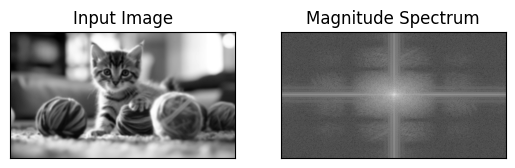

In [ ]:
# Blur the grayscale image by a Guassian filter with kernel size of 10
imBlur = cv.blur(gray_image,(5,5))
# Transform the image to frequency domain
f = np.fft.fft2(imBlur)
# Bring the zero-frequency component to the center
fshift = np.fft.fftshift(f)
magnitude_spectrum = 30*np.log(np.abs(fshift))

plt.subplot(121),plt.imshow(imBlur, cmap = 'gray')
plt.title('Input Image'), plt.xticks([]), plt.yticks([])
plt.subplot(122),plt.imshow(magnitude_spectrum, cmap = 'gray')
plt.title('Magnitude Spectrum'), plt.xticks([]), plt.yticks([])
plt.show()

#### TODO: Generate a Fourier Transform of your grayscale image

In [ ]:
# todo: Implement your code here


### Finding Edges by Highpass Filtering in FFT

This section demonstrates conducting a high pass filter to remove the low frequency component, resulting in a sharpened image which contains the edges

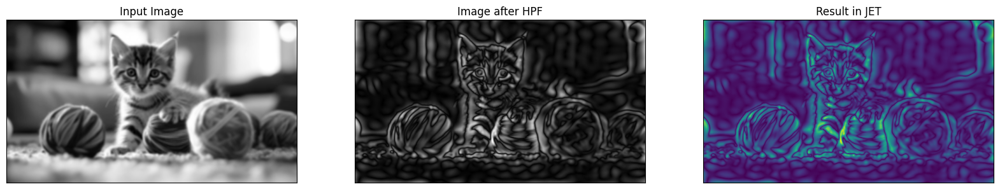

In [ ]:
rows, cols = imBlur.shape
crow,ccol = round(rows/2) , round(cols/2)
# remove low frequencies with a rectangle size of 10
fshift[crow-10:crow+10, ccol-10:ccol+10] = 0
f_ishift = np.fft.ifftshift(fshift)
img_back = np.fft.ifft2(f_ishift)
img_back = np.abs(img_back)

plt.figure(figsize=([20, 20]))
plt.subplot(131),plt.imshow(imBlur, cmap = 'gray')
plt.title('Input Image'), plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(img_back, cmap = 'gray')
plt.title('Image after HPF'), plt.xticks([]), plt.yticks([])
plt.subplot(133),plt.imshow(img_back)
plt.title('Result in JET'), plt.xticks([]), plt.yticks([])
plt.show()